##### Part A:  _Installing and importing all the required packages_

In [ ]:
# Baseline to establish the benchmark and compare, gym-retro, and gym
!pip install gym-retro
!pip install gym
!pip install stable-baselines[mpi]

In [ ]:
import retro
import gym
import math
import random
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from collections import namedtuple
from itertools import count
from PIL import Image

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as T

##### Part B: _Importing the ROM_

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!python -m retro.import /content/drive/My\ Drive/APS360/Project/

Importing FerrariGrandPrixChallenge-Genesis
Imported 1 games


##### _Part C: Environment Setup_

In [ ]:
Transition = namedtuple('Transition', ('state', 'action', 'next_state', 'reward'))

class ReplayMemory(object):
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = []
        self.position = 0

    def push(self, *args):
        """Saves a transition."""
        spl = random.random()
        if spl > DECORRELATATION_CONSTANT: 
          if len(self.memory) < self.capacity:
              self.memory.append(None)
          self.memory[self.position] = Transition(*args)
          self.position = (self.position + 1) % self.capacity

    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)

    def __len__(self):
        return len(self.memory)

# Defining the discrete actions/combos 
class Discretizer(gym.ActionWrapper):
    """
    Wrap a gym environment and make it use discrete actions.
    Args:
        combos: ordered list of lists of valid button combinations
    """
    def __init__(self, env, combos):
        super().__init__(env)
        assert isinstance(env.action_space, gym.spaces.MultiBinary)
        buttons = env.unwrapped.buttons
        print(buttons)
        self._decode_discrete_action = []
        for combo in combos:
            arr = np.array([False] * env.action_space.n)
            for button in combo:
                arr[buttons.index(button)] = True
            self._decode_discrete_action.append(arr)
        self.action_space = gym.spaces.Discrete(len(self._decode_discrete_action))

    def action(self, act):
        return self._decode_discrete_action[act].copy()

class My(Discretizer):
    def __init__(self, env):
        super().__init__(env=env, combos=[['A'], ['B'], ['LEFT', 'A'], ['RIGHT', 'A']])

# Setting up matplotlib
is_ipython = 'inline' in matplotlib.get_backend()
if is_ipython:
    from IPython import display

plt.ion()

# Setting up GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
env = My(retro.make(game='FerrariGrandPrixChallenge-Genesis'))
print('My action_space', env.action_space)

['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
My action_space Discrete(4)


torch.Size([1, 3, 50, 320])


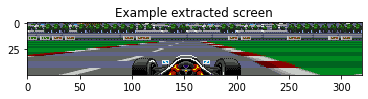

In [ ]:
resize = T.Compose([T.ToPILImage(), T.ToTensor()])

def getScreen(): 
  screen = env.get_screen()
  screen = screen[174:]
  screen = screen.transpose((2,0,1))
  screen = np.ascontiguousarray(screen, dtype=np.float32) / 255
  screen = torch.from_numpy(screen)
  return resize(screen).unsqueeze(0).to(device)

env.reset()
obs = getScreen() 
print(obs.shape)
plt.figure()
plt.imshow(obs.cpu().squeeze(0).permute(1, 2, 0).numpy(),interpolation='none')
plt.title('Example extracted screen')
plt.show()

##### _Part D: Deep Q-Network_

In [ ]:
class DQN(nn.Module): 
  def __init__(self, ImageHeight, ImageWidth, otp, channel=(10, 17, 25), kernelSize=2, strideSize=2):
    super(DQN, self).__init__()
    self.Features = nn.Sequential(
        nn.Conv2d(3, channel[0], kernel_size=kernelSize, stride=strideSize),
        nn.BatchNorm2d(channel[0]),
        nn.ReLU(),
        nn.Conv2d(channel[0], channel[1], kernel_size=kernelSize, stride=strideSize),
        nn.BatchNorm2d(channel[1]),
        nn.ReLU(),
        nn.Conv2d(channel[1], channel[2], kernel_size=kernelSize, stride=strideSize),
        nn.BatchNorm2d(channel[2]),
        nn.ReLU())
    
    def conv2d_size_out(size, kernel_size = kernelSize, stride = strideSize):
      return int(((size - (kernel_size - 1) - 1) // stride  + 1))

    convW = conv2d_size_out(conv2d_size_out(conv2d_size_out(ImageWidth)))
    convH = conv2d_size_out(conv2d_size_out(conv2d_size_out(ImageHeight)))


    self.Classifier = nn.Sequential(
        nn.Dropout(p=0.3),
        nn.Linear(channel[2]*convW*convH, 250),
        nn.ReLU(),
        nn.Linear(250, 75),
        nn.ReLU(),
        nn.Linear(75, otp))
    
    self.channel = channel 
    self.convH = convH
    self.convW = convW
  
  def forward(self, img): 
    output = self.Features(img)
    output = output.view(-1, self.channel[2] * self.convH * self.convW)
    output = self.Classifier(output)
    return output

print(DQN(50, 320, 9))

DQN(
  (Features): Sequential(
    (0): Conv2d(3, 10, kernel_size=(2, 2), stride=(2, 2))
    (1): BatchNorm2d(10, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(10, 17, kernel_size=(2, 2), stride=(2, 2))
    (4): BatchNorm2d(17, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(17, 25, kernel_size=(2, 2), stride=(2, 2))
    (7): BatchNorm2d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
  )
  (Classifier): Sequential(
    (0): Dropout(p=0.3, inplace=False)
    (1): Linear(in_features=6000, out_features=250, bias=True)
    (2): ReLU()
    (3): Linear(in_features=250, out_features=75, bias=True)
    (4): ReLU()
    (5): Linear(in_features=75, out_features=9, bias=True)
  )
)


In [ ]:
def select_action(state, steps_done):
    sample = random.random()    
    eps_threshold = EPS_END + (EPS_START - EPS_END) * \
        math.exp(-1. * steps_done / EPS_DECAY)
    if sample > eps_threshold:
        with torch.no_grad():
            actions = policy_net(state)
            return actions.max(1)[1].view(1, 1)
    else:
      return torch.tensor([[random.randrange(n_actions)]], device=device, dtype=torch.long)

In [ ]:
def optimize_model():
    if len(memory) < BATCH_SIZE:
        return
    transitions = memory.sample(BATCH_SIZE)
    batch = Transition(*zip(*transitions))

    # Compute a mask of non-final states and concatenate the batch elements
    # (a final state would've been the one after which simulation ended)
    non_final_mask = torch.tensor(tuple(map(lambda s: s is not None,
                                          batch.next_state)), device=device, dtype=torch.bool)
    non_final_next_states = torch.cat([s for s in batch.next_state
                                                if s is not None])
    state_batch = torch.cat(batch.state)
    action_batch = torch.cat(batch.action)
    reward_batch = torch.cat(batch.reward)

    # Compute Q(s_t, a) - the model computes Q(s_t), then we select the
    # columns of actions taken. These are the actions which would've been taken
    # for each batch state according to policy_net
    state_action_values = policy_net(state_batch).gather(1, action_batch)

    # Compute V(s_{t+1}) for all next states.
    # Expected values of actions for non_final_next_states are computed based
    # on the "older" target_net; selecting their best reward with max(1)[0].
    # This is merged based on the mask, such that we'll have either the expected
    # state value or 0 in case the state was final.
    next_state_values = torch.zeros(BATCH_SIZE, device=device)
    next_state_values[non_final_mask] = target_net(non_final_next_states).max(1)[0].detach()
    
    # Compute the expected Q values
    expected_state_action_values = (next_state_values * GAMMA) + reward_batch

    # Compute Huber loss
    loss = F.smooth_l1_loss(state_action_values, expected_state_action_values.unsqueeze(1))

    # Optimize the model
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

##### _Part E: Main Training_

In [ ]:
def getReward(speed, prevSpeed, screen, action): 
  if action == 0 and ((screen[215,80,0] != 0 and screen[215,80,2] != 32) and (screen[215,220,0] != 0 and screen[215,220,2] != 32)):
    reward = torch.tensor([speed+10], dtype=torch.long, device=device)
  elif (screen[215,80,0] == 0 and screen[215,80,2] == 32 and action == 3): 
    reward = torch.tensor([speed+10], dtype=torch.long, device=device)
  elif (screen[215,220,0] == 0 and screen[215,220,2] == 32 and action == 2): 
    reward = torch.tensor([speed+10], dtype=torch.long, device=device)
  elif (screen[215,95,0] == 0 and screen[215,95,2] == 32) or (screen[215,205,0] == 0 and screen[215,205,2] == 32): 
    reward = torch.tensor([-1*speed], dtype=torch.long, device=device)
  elif speed == 0:
    reward = torch.tensor([-10], dtype=torch.long, device=device)
  else: 
    reward = torch.tensor([speed], dtype=torch.long, device=device) 
  return reward


In [ ]:
BATCH_SIZE = 128
DIVERSIFY_MEMORY = 0.25
MEMORY_CAPACITY = 8500

GAMMA = 0.75
LEARNING_RATE = 0.05

EPS_START = 0.9
EPS_END = 0.1
EPS_DECAY = 21000

MAX_EPISODES = 17

torch.manual_seed(11)
random.seed(11)
np.random.seed(11)

init_screen = getScreen()
_, _, screen_height, screen_width = init_screen.shape
n_actions = env.action_space.n

if torch.cuda.is_available(): 
  print(">> Training using CUDA")

policy_net = DQN(screen_height, screen_width, n_actions).to(device)
target_net = DQN(screen_height, screen_width, n_actions).to(device)
target_net.load_state_dict(policy_net.state_dict())
target_net.eval()

optimizer = optim.Adam(policy_net.parameters(), lr=LEARNING_RATE)
memory = ReplayMemory(MEMORY_CAPACITY)

num_episodes = MAX_EPISODES
for i_episode in range(num_episodes):
  # Initialize the environment and state
  env.reset()
  state = getScreen()
  prevSpeed, totalReward, totalSpeed  = 0, 0, 0
  lap, prevT = 1, 0
  action = select_action(state, 0)
  print(">> Episode {} started ".format(i_episode+1))
  for t in count():
    # Select and perform an action
    action = select_action(state, t)
    obs, reward, done, info = env.step(action)

    speed = info['speed'] 
    reward = getReward(speed, prevSpeed, env.get_screen(), action.item())       
    prevSpeed = speed

    if info['time'] > 0:
      totalReward += reward.item()
      totalSpeed += speed
      # Store the transition in memory
      memory.push(state, action, next_state, reward)
    
    if t % 2000 == 0: 
      print("Episode - {:3d}, Step - {:7d}, Reward - {:8d}, Lap - {:2d}, Time - {:7d}".format(i_episode+1, t, totalReward, info['lap'], info['time']))
    
    next_state = getScreen() if not done else None

    # Move to the next state
    state = next_state

    if lap != info['lap'] and info['lap'] != 0: 
      N = (t+1) - prevT
      print("> Episode {} lap {} completed at avg speed of {:.2f} and avg reward of {:.2f}!".format(i_episode+1, lap, totalSpeed/N, totalReward/N))
      totalReward, totalSpeed = 0, 0
      prevT = (t+1)
      lap = info['lap']

    # Perform one step of the optimization (on the target network)
    if info['time'] > 0 and t%2 == 0: 
      optimize_model()

    if done:
      break
        
  # Update the target network, copying all weights and biases in DQN
  target_net.load_state_dict(policy_net.state_dict())
  print("> Episode {} Best Lap - {}".format(i_episode+1, info['best_lap']))
  torch.save(policy_net.state_dict(), "/content/drive/My Drive/APS360/Project/Models/Model_{}_{}".format(i_episode+1, info['best_lap']))

print('Complete')
env.close()

>> Training using CUDA


NameError: ignored

In [ ]:
torch.save(policy_net.state_dict(), "/content/drive/My Drive/APS360/Project/Best Model/Best_Model_10070")

##### _Part F: Testing_

In [ ]:
# Loading the Model
policy_net = DQN(screen_height, screen_width, n_actions).to(device)
policy_net.load_state_dict(torch.load("/content/drive/My Drive/APS360/Project/Best Model/Best_Model_10070"))
#target_net = DQN(screen_height, screen_width, n_actions).to(device)
#target_net.load_state_dict(policy_net.state_dict())
#target_net.eval()

<All keys matched successfully>

In [ ]:
env.close()
env = My(retro.make(game='FerrariGrandPrixChallenge-Genesis', record='.'))
#policy_net = torch.load("/content/drive/My Drive/APS360/Project/Best_Model")
num_episodes = 1
torch.manual_seed(111)
episode_duration = []
AvgRewards = []
AvgSpeed = []
lapTime = np.zeros((num_episodes,5))
pn = policy_net.eval()
for i_episode in range(num_episodes):
  # Initialize the environment and state
  env.reset()
  last_screen = getScreen()
  current_screen = getScreen()
  state = last_screen
  prevSpeed, totalReward, totalSpeed  = 0, 0, 0
  lap = 1
  prevT = 0
  actions = pn(state).max(1)[1].view(1, 1)
  print(">> Episode {} started ".format(i_episode))
  for t in count():
    # Select and perform an action
    action = pn(state).max(1)[1].view(1, 1)

    obs, reward, done, info = env.step(action)

    screen = env.get_screen()
    speed = info['speed'] 

    if speed == 0 or speed < prevSpeed:
      reward = torch.tensor([-1], dtype=torch.long, device=device)
    elif speed > prevSpeed: 
      reward = torch.tensor([1], dtype=torch.long, device=device)
    else: 
      reward = torch.tensor([0], dtype=torch.long, device=device)        

    prevSpeed = speed

    if info['time'] > 0:
      totalReward += reward.item()
      totalSpeed += speed

    # Observe new state
    last_screen = current_screen
    current_screen = getScreen()

        
    if t % 1000 == 0: 
      print("Episode - {:3d}, Step - {:7d}, Reward - {:3d}, Lap - {:2d}, Time - {:7d}".format(i_episode, t, totalReward, info['lap'], info['time']))
    
    if not done:
        #next_state = current_screen - last_screen
        next_state = current_screen
    else:
        next_state = None

    # Move to the next state
    state = next_state

    lapTime[i_episode, info['lap']] = info['time']
    if lap != info['lap'] and info['lap'] != 0: 
      print(">> Episode {} lap {} completed at step {}!".format(i_episode, lap, t))
      N = (t+1) - prevT
      episode_duration.append(N)
      AvgRewards.append(totalReward/N)
      AvgSpeed.append(totalSpeed/N)
      totalReward, totalSpeed = 0, 0
      prevT = (t+1)
      lap = info['lap']

    # Perform one step of the optimization (on the target network)
    if done:
        break

print('Complete')
env.close()

['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
Episode -   0, Step -       0, Reward -   0, Lap -  1, Time -       0
Episode -   0, Step -    1000, Reward -  62, Lap -  1, Time -    1439
Episode -   0, Step -    2000, Reward - 263, Lap -  1, Time -    2939
Episode -   0, Step -    3000, Reward - 481, Lap -  1, Time -    4439
Episode -   0, Step -    4000, Reward - 654, Lap -  1, Time -    5939
Episode -   0, Step -    5000, Reward - 874, Lap -  1, Time -   11439
>> Episode 0 lap 1 completed at step 5787!
Episode -   0, Step -    6000, Reward -  37, Lap -  2, Time -     319
Episode -   0, Step -    7000, Reward - 176, Lap -  2, Time -    1819
Episode -   0, Step -    8000, Reward - 356, Lap -  2, Time -    3319
Episode -   0, Step -    9000, Reward - 500, Lap -  2, Time -    4819
>> Episode 0 lap 2 completed at step 9859!
Episode -   0, Step -   10000, Reward -  10, Lap -  3, Time -     211
Episode -   0, Step -   11000, Reward - 171

In [ ]:
print(AvgRewards)
print(AvgSpeed)
print(lapTime)
print(episode_duration) 

[0.1762266758811334, 0.16601178781925344, 0.17712450592885376]
[129.271596406358, 172.2524557956778, 159.10474308300394]
[[    0. 12618. 10106. 10070.     0.]]
[5788, 4072, 4048]


In [ ]:
graphSpeed = [43.85165094339623, 36.168567961165046, 55.30250506072875, 45.23541862652869, 70.99882629107981, 56.008792048929664, 55.14744525547445, 53.86981509245377, 56.37771053958649, 52.519119070667955, 56.24646286003032, 66.69487983281087, 44.68764902241297, 66.386178861788615, 52.8506017791732, 69.853532748839605, 76.53964401294499, 80.58791371158392]
graphReward = [0.03336037735849057, 0.027909344660194176, 0.04521546052631579, 0.03580032925682032, 0.05694457485654669, 0.045482288481141694, 0.04146812652068127, 0.04069265367316342, 0.045620272314674736, 0.03905469506292352, 0.04430078322385043, 0.049794670846394986, 0.03411301859799714, 0.04668140243902439, 0.052665358451072734, 0.04054556412729026, 0.05038318720990201, 0.06172545846817692]
x = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18]

plt.xticks(range(1,19))

plt.title("Average Reward")
plt.plot(x, graphReward, 'k', label="Average Reward")
plt.xlabel("Laps")
plt.ylabel("Average Reward")
plt.legend(loc='best')
plt.show()

plt.xticks(range(1,19))

plt.title("Average Speed")
plt.plot(x, graphSpeed, 'r', label="Average Speed")
plt.xlabel("Laps")
plt.ylabel("Average Speed")
plt.legend(loc='best')
plt.show()

print(len(graphSpeed))

##### _Part G: Live Model_

['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
Episode -   0, Step -       0, Reward -   0, Lap -  1, Time -       0


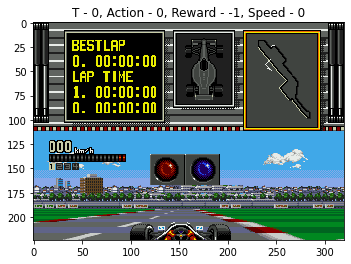

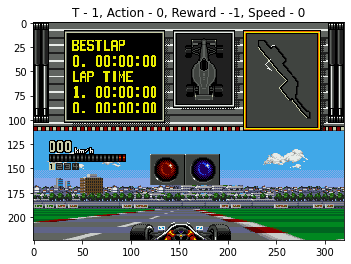

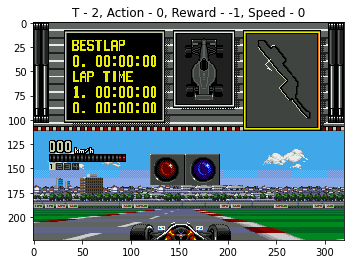

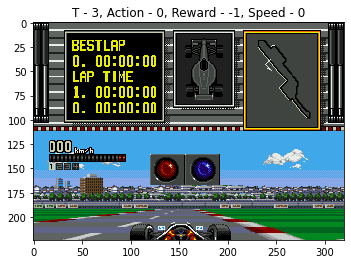

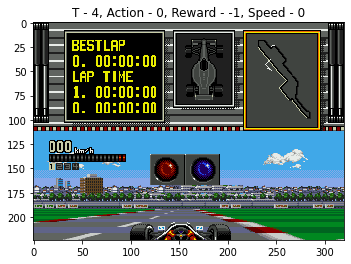

...

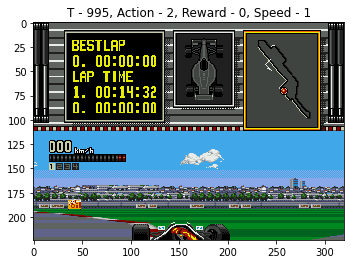

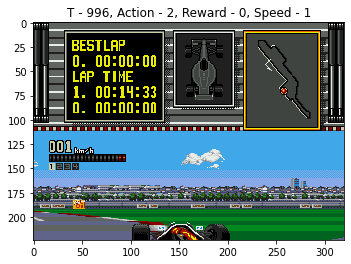

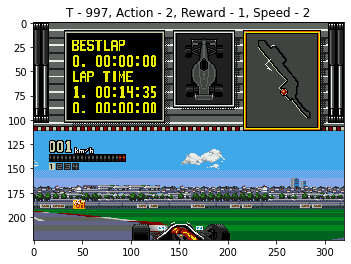

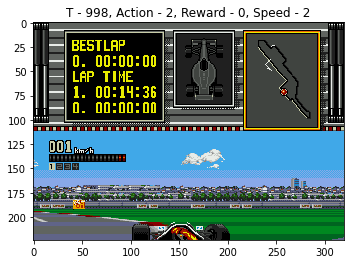

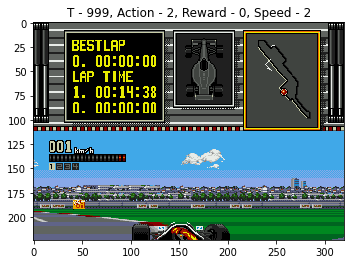

Episode -   0, Step -    1000, Reward - 132, Lap -  1, Time -    1439


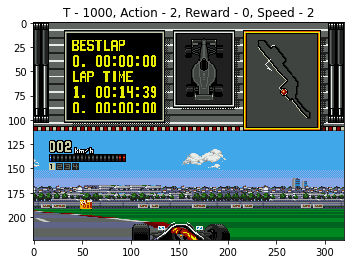

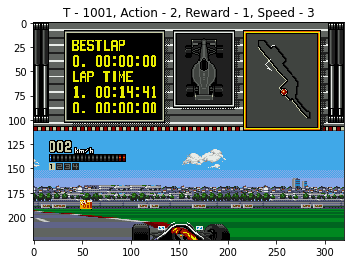

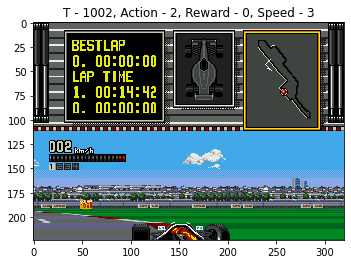

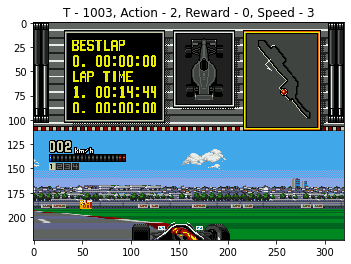

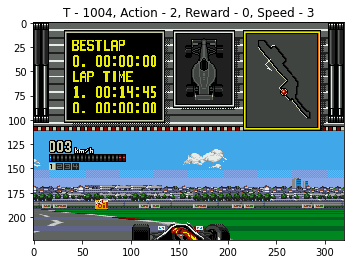

...

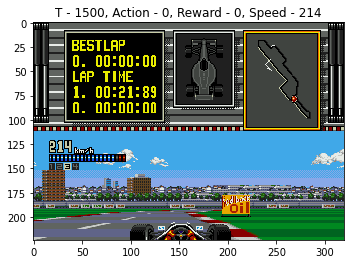

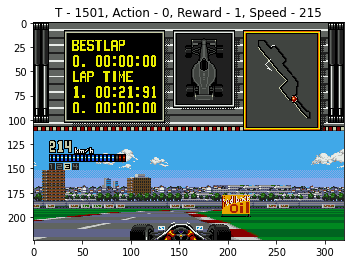

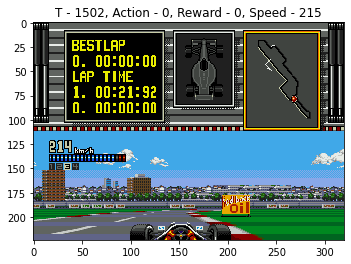

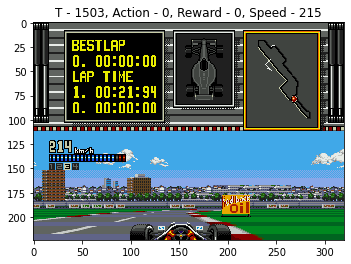

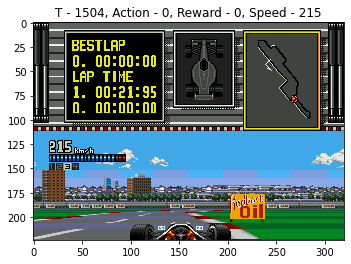

KeyboardInterrupt: ignored

<Figure size 432x288 with 0 Axes>

In [ ]:
env = My(retro.make(game='FerrariGrandPrixChallenge-Genesis'))
num_episodes = 1
torch.manual_seed(111)
episode_duration = []
AvgRewards = []
AvgSpeed = []
lapTime = np.zeros((num_episodes,5))
pn = policy_net.eval()
for i_episode in range(num_episodes):
  # Initialize the environment and state
  env.reset()
  last_screen = getScreen()
  current_screen = getScreen()
  state = last_screen
  prevSpeed, totalReward, totalSpeed  = 0, 0, 0
  lap = 1
  prevT = 0
  actions = pn(state).max(1)[1].view(1, 1)
  print(">> Episode {} started ".format(i_episode))
  for t in count():
    # Select and perform an action
    action = pn(state).max(1)[1].view(1, 1)

    obs, reward, done, info = env.step(action)

    screen = env.get_screen()
    speed = info['speed'] 

    if speed == 0 or speed < prevSpeed:
      reward = torch.tensor([-1], dtype=torch.long, device=device)
    elif speed > prevSpeed: 
      reward = torch.tensor([1], dtype=torch.long, device=device)
    else: 
      reward = torch.tensor([0], dtype=torch.long, device=device)        

    prevSpeed = speed

    if info['time'] > 0:
      totalReward += reward.item()
      totalSpeed += speed

    # Observe new state
    last_screen = current_screen
    current_screen = getScreen()

        
    if t % 1000 == 0: 
      print("Episode - {:3d}, Step - {:7d}, Reward - {:3d}, Lap - {:2d}, Time - {:7d}".format(i_episode, t, totalReward, info['lap'], info['time']))
    
    plt.figure()
    plt.imshow(env.get_screen(), interpolation='none')
    plt.title("T - {}, Action - {}, Reward - {}, Speed - {}".format(t, action.item(), reward.item(), info['speed']))
    plt.show()

    if not done:
        #next_state = current_screen - last_screen
        next_state = current_screen
    else:
        next_state = None

    # Move to the next state
    state = next_state

    lapTime[i_episode, info['lap']] = info['time']
    if lap != info['lap'] and info['lap'] != 0: 
      print(">> Episode {} lap {} completed at step {}!".format(i_episode, lap, t))
      N = (t+1) - prevT
      episode_duration.append(N)
      AvgRewards.append(totalReward/N)
      AvgSpeed.append(totalSpeed/N)
      totalReward, totalSpeed = 0, 0
      prevT = (t+1)
      lap = info['lap']

    # Perform one step of the optimization (on the target network)
    if done:
        break

print('Complete')
env.close()

##### _Part H: Transfer Learning_

In [ ]:
# Loading the Model
policy_net = DQN(screen_height, screen_width, n_actions).to(device)
policy_net.load_state_dict(torch.load("/content/drive/My Drive/APS360/Project/Best Model/ExcellentDriver_15_13696"))

<All keys matched successfully>

In [ ]:
env.close()

In [ ]:
track = "/content/drive/My Drive/APS360/Project/States/belgium_track.state"
env = My(retro.make(game='FerrariGrandPrixChallenge-Genesis', state=track, record='.'))
#policy_net = torch.load("/content/drive/My Drive/APS360/Project/Best_Model")
num_episodes = 1
torch.manual_seed(111)
episode_duration = []
AvgRewards = []
AvgSpeed = []
lapTime = np.zeros((num_episodes,5))
pn = policy_net.eval()
for i_episode in range(num_episodes):
  # Initialize the environment and state
  env.reset()
  last_screen = getScreen()
  current_screen = getScreen()
  state = last_screen
  prevSpeed, totalReward, totalSpeed  = 0, 0, 0
  lap = 1
  prevT = 0
  actions = pn(state).max(1)[1].view(1, 1)
  print(">> Episode {} started ".format(i_episode))
  for t in count():
    # Select and perform an action
    action = pn(state).max(1)[1].view(1, 1)

    obs, reward, done, info = env.step(action)

    screen = env.get_screen()
    speed = info['speed'] 

    if speed == 0 or speed < prevSpeed:
      reward = torch.tensor([-1], dtype=torch.long, device=device)
    elif speed > prevSpeed: 
      reward = torch.tensor([1], dtype=torch.long, device=device)
    else: 
      reward = torch.tensor([0], dtype=torch.long, device=device)        

    prevSpeed = speed

    if info['time'] > 0:
      totalReward += reward.item()
      totalSpeed += speed

    # Observe new state
    last_screen = current_screen
    current_screen = getScreen()

        
    if t % 1000 == 0: 
      print("Episode - {:3d}, Step - {:7d}, Reward - {:3d}, Lap - {:2d}, Time - {:7d}".format(i_episode, t, totalReward, info['lap'], info['time']))
    
    if not done:
        #next_state = current_screen - last_screen
        next_state = current_screen
    else:
        next_state = None

    # Move to the next state
    state = next_state

    lapTime[i_episode, info['lap']] = info['time']
    if lap != info['lap'] and info['lap'] != 0: 
      print(">> Episode {} lap {} completed at step {}!".format(i_episode, lap, t))
      N = (t+1) - prevT
      episode_duration.append(N)
      AvgRewards.append(totalReward/N)
      AvgSpeed.append(totalSpeed/N)
      totalReward, totalSpeed = 0, 0
      prevT = (t+1)
      lap = info['lap']

    # Perform one step of the optimization (on the target network)
    if done:
        break

print('Complete')
env.close()

['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
Episode -   0, Step -       0, Reward -   0, Lap -  1, Time -       0
Episode -   0, Step -    1000, Reward - 190, Lap -  1, Time -    1374
Episode -   0, Step -    2000, Reward - 297, Lap -  1, Time -    2874
Episode -   0, Step -    3000, Reward - 452, Lap -  1, Time -    4374
Episode -   0, Step -    4000, Reward - 563, Lap -  1, Time -    5874
Episode -   0, Step -    5000, Reward - 764, Lap -  1, Time -   11374
>> Episode 0 lap 1 completed at step 5233!
Episode -   0, Step -    6000, Reward - 131, Lap -  2, Time -    1151
Episode -   0, Step -    7000, Reward - 214, Lap -  2, Time -    2651
Episode -   0, Step -    8000, Reward - 390, Lap -  2, Time -    4151
Episode -   0, Step -    9000, Reward - 549, Lap -  2, Time -    5651
>> Episode 0 lap 2 completed at step 9897!
Episode -   0, Step -   10000, Reward -   0, Lap -  3, Time -     155
Episode -   0, Step -   11000, Reward - 157

In [ ]:
print(AvgRewards)
print(AvgSpeed)
print(lapTime)
print(episode_duration) 

[0.1469239587313718, 0.1483704974271012, 0.14444911690496215]
[190.8288116163546, 201.06496569468268, 201.0073591253154]
[[    0. 11722. 10995. 11133.     0.]]
[5234, 4664, 4756]


##### _Part I: Heuristic Agent_

In [ ]:
env.close()

In [ ]:
track = "/content/drive/My Drive/APS360/Project/States/belgium_track.state"
env = My(retro.make(game='FerrariGrandPrixChallenge-Genesis', record='.'))
num_episodes = 1
torch.manual_seed(111)
episode_duration = []
AvgRewards = []
AvgSpeed = []
lapTime = np.zeros((3,5))
for i_episode in range(num_episodes):
    print(i_episode)
    # Initialize the environment and state
    env.reset()
    prevSpeed = 0
    totalReward = 0
    totalSpeed = 0
    lap = 1
    prevT = 0
    grass = 0
    for t in count():


        screen = env.get_screen()

        if (screen[215,80,0] == 0 and screen[215,80,2] == 32): 
          action = torch.tensor([[3]], device=device, dtype=torch.long)
        elif (screen[215,220,0] == 0 and screen[215,220,2] == 32): 
          action = torch.tensor([[2]], device=device, dtype=torch.long)
        else: 
          action = torch.tensor([[0]], device=device, dtype=torch.long)
        
        obs, reward, done, info = env.step(action)

        totalSpeed += info['speed']
        
        '''
        plt.figure()
        plt.imshow(env.get_screen(), interpolation='none')
        plt.title("T - {}, Action - {}, Speed - {}".format(t, action.item(), info['speed']))
        plt.show()
        '''

        if t % 500 == 0: 
          print("T - {}, Action - {}, Speed - {}".format(t, action.item(), info['speed']))


        lapTime[i_episode, info['lap']] = info['time']

        if lap != info['lap'] and info['lap'] != 0: 
          N = (t+1) - prevT
          episode_duration.append(N)
          AvgRewards.append(totalReward/N)
          AvgSpeed.append(totalSpeed/N)
          totalReward = 0
          totalSpeed = 0
          prevT = (t+1)
          lap = info['lap']

        # Perform one step of the optimization (on the target network)
        
        if done:
            break
          

print('Complete')
env.close()

['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
0
T - 0, Action - 0, Speed - 0
T - 500, Action - 0, Speed - 173
T - 1000, Action - 2, Speed - 2
T - 1500, Action - 0, Speed - 214
T - 2000, Action - 0, Speed - 146
T - 2500, Action - 0, Speed - 115
T - 3000, Action - 3, Speed - 316
T - 3500, Action - 0, Speed - 25
T - 4000, Action - 0, Speed - 6
T - 4500, Action - 0, Speed - 218
T - 5000, Action - 0, Speed - 294
T - 5500, Action - 2, Speed - 157
T - 6000, Action - 0, Speed - 126
T - 6500, Action - 2, Speed - 45
T - 7000, Action - 0, Speed - 257
T - 7500, Action - 0, Speed - 5
T - 8000, Action - 0, Speed - 217
T - 8500, Action - 2, Speed - 161
T - 9000, Action - 0, Speed - 334
T - 9500, Action - 0, Speed - 137
T - 10000, Action - 0, Speed - 106
T - 10500, Action - 0, Speed - 25
T - 11000, Action - 0, Speed - 237
T - 11500, Action - 0, Speed - 331
T - 12000, Action - 0, Speed - 160
T - 12500, Action - 0, Speed - 141
Complete


In [ ]:
print(AvgRewards)
print(AvgSpeed)
print(lapTime)
print(episode_duration) 

[0.0, 0.0, 0.0]
[151.71153846153845, 160.58529411764707, 160.58529411764707]
[[    0. 11112. 10118. 10118.     0.]
 [    0.     0.     0.     0.     0.]
 [    0.     0.     0.     0.     0.]]
[4784, 4080, 4080]


##### _Part J: Data Generation_

In [ ]:
env.close()
AvgRewards = []
AvgSpeed = []
lapTime = np.zeros((43,5))
for run in range(43):
  policy_net = DQN(screen_height, screen_width, n_actions).to(device)
  policy_net.load_state_dict(torch.load("/content/drive/My Drive/APS360/Project/Models/DATA_GEN/{}".format(run+1)))
  env = My(retro.make(game='FerrariGrandPrixChallenge-Genesis'))
  #policy_net = torch.load("/content/drive/My Drive/APS360/Project/Best_Model")
  num_episodes = 1
  torch.manual_seed(111)
  episode_duration = []
  pn = policy_net.eval()
  for i_episode in range(num_episodes):
    # Initialize the environment and state
    env.reset()
    last_screen = getScreen()
    current_screen = getScreen()
    state = last_screen
    prevSpeed, totalReward, totalSpeed  = 0, 0, 0
    lap = 1
    prevT = 0
    actions = pn(state).max(1)[1].view(1, 1)
    print(">> Episode {} started ".format(i_episode))
    for t in count():
      if t >= 25000: 
        break
      # Select and perform an action
      action = pn(state).max(1)[1].view(1, 1)

      obs, reward, done, info = env.step(action)

      screen = env.get_screen()
      speed = info['speed'] 

      if speed == 0 or speed < prevSpeed:
        reward = torch.tensor([-10], dtype=torch.long, device=device)
      elif speed > prevSpeed: 
        reward = torch.tensor([5], dtype=torch.long, device=device)
      else: 
        reward = torch.tensor([1], dtype=torch.long, device=device)        

      prevSpeed = speed

      if info['time'] > 0:
        totalReward += reward.item()
        totalSpeed += speed

      # Observe new state
      last_screen = current_screen
      current_screen = getScreen()

          
      #if t % 5000 == 0: 
      #  print("Episode - {:3d}, Step - {:7d}, Reward - {:3d}, Lap - {:2d}, Time - {:7d}".format(i_episode, t, totalReward, info['lap'], info['time']))
      
      if not done:
          #next_state = current_screen - last_screen
          next_state = current_screen
      else:
          next_state = None

      # Move to the next state
      state = next_state

      lapTime[run, info['lap']] = info['time']
      if lap != info['lap'] and info['lap'] != 0: 
        #print(">> Episode {} lap {} completed at step {}!".format(i_episode, lap, t))
        N = (t+1) - prevT
        episode_duration.append(N)
        AvgRewards.append(totalReward/N)
        AvgSpeed.append(totalSpeed/N)
        totalReward, totalSpeed = 0, 0
        prevT = (t+1)
        lap = info['lap']

      # Perform one step of the optimization (on the target network)
      if done:
          break

  print('>> Run {} Completed'.format(run+1))
  env.close()

['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 1 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 2 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 3 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 4 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 5 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 6 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 7 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN', 'LEFT', 'RIGHT', 'C', 'Y', 'X', 'Z']
>> Episode 0 started 
>> Run 8 Completed
['B', 'A', 'MODE', 'START', 'UP', 'DOWN'

In [ ]:
a = AvgRewards
b = AvgSpeed
c = np.copy(lapTime)

[0.7050711743772242, 0.6692402717726992, 0.6575505350772889, 1.35453034081463, 1.440305635148042, 1.4193147964250248, 1.5717722534081797, 1.5930799220272904, 1.4744455159112826, 1.2575976845151953, 1.1815567484662577, 1.3194769711163155, 1.5106605351170568, 1.593150684931507, 1.6478713768115942, 0.7716860109957239, 0.9386942675159236, 1.1826452064380686, 0.9614465032875075, 0.9404520917678812, 1.2776731927710843, 1.1039712320200126, 0.9781790820165538, 0.9158011869436202, 0.8273305084745762, 0.84375, 0.9828447701532311, 1.0141369047619047, 0.8377997179125529, 1.5405868902439024, 1.627659574468085, 1.5977393617021276, 1.5720274390243902, 1.559782608695652, 1.5853494623655915, 1.4392396469789546, 1.3719785138764549, 1.482765780730897, 1.5309220389805098, 1.6359245630174792, 1.5321492805755397, 1.5818754373687893, 1.6213570127504553, 1.6325757575757576, 1.5645979703356752, 1.6215784671532847, 1.681077694235589, 1.5801526717557253, 1.6298932384341638, 1.6099290780141844, 1.5999219359875099

In [ ]:
import numpy as np
import random
a = [0.7050711743772242, 0.6692402717726992, 0.6575505350772889, 1.35453034081463, 1.440305635148042, 1.4193147964250248, 1.5717722534081797, 1.5930799220272904, 1.4744455159112826, 1.2575976845151953, 1.1815567484662577, 1.3194769711163155, 1.5106605351170568, 1.593150684931507, 1.6478713768115942, 0.7716860109957239, 0.9386942675159236, 1.1826452064380686, 0.9614465032875075, 0.9404520917678812, 1.2776731927710843, 1.1039712320200126, 0.9781790820165538, 0.9158011869436202, 0.8273305084745762, 0.84375, 0.9828447701532311, 1.0141369047619047, 0.8377997179125529, 1.5405868902439024, 1.627659574468085, 1.5977393617021276, 1.5720274390243902, 1.559782608695652, 1.5853494623655915, 1.4392396469789546, 1.3719785138764549, 1.482765780730897, 1.5309220389805098, 1.6359245630174792, 1.5321492805755397, 1.5818754373687893, 1.6213570127504553, 1.6325757575757576, 1.5645979703356752, 1.6215784671532847, 1.681077694235589, 1.5801526717557253, 1.6298932384341638, 1.6099290780141844, 1.5999219359875099, 1.487092391304348, 1.6095348837209302, 1.099820143884892, 1.4197437829691033, 1.0902877697841726, 1.5405868902439024, 1.6222953904045154, 1.5069101678183614, 1.49734477124183, 1.5335, 1.554, 1.3975787855495772, 1.513272583201268, 1.4644261006289307, 1.577961019490255, 1.6021161417322836, 1.6021161417322836, 1.4736951118475559, 1.6716450216450216, 1.5993478260869565, 1.5186036789297659, 1.5878136200716846, 1.6451241950321986, 1.6278877887788779, 1.612231182795699, 1.5875486381322956, 1.606967213114754, 1.505392156862745, 1.6253488372093023, 1.5769079464988198, 1.5527325023969318, 1.5984251968503937, 1.616565579984837, 1.530031612223393, 1.5444664031620554, 1.5598184818481848, 1.524047619047619, 1.625915750915751, 1.4979674796747968, 1.5849271402550091, 1.688071297989031, 1.456634692246203, 1.5668979187314171, 1.675813953488372, 0.9545454545454546, 0.9621551081282624, 1.0914937759336099, 1.5657393292682926, 1.5977393617021276, 1.5977393617021276, 1.5186036789297659, 1.556312443233424, 1.6571682991985752, 1.560594512195122, 1.6854347826086957, 1.6424755120213714, 1.6599400299850075, 1.7225023786869648, 1.7955882352941178, 1.7965882352941178, 1.7865882352941178]
b = [118.16607354685647, 123.0710315009265, 115.49048751486326, 155.5652535328346, 165.47277936962752, 185.92850049652432, 154.0633520449078, 158.81286549707602, 155.2695274831244, 152.37192474674384, 162.8611963190184, 153.27166276346605, 151.45150501672242, 156.1767123287671, 149.5101902173913, 121.55314599877825, 130.27850318471337, 140.63051084674598, 118.96951583980872, 132.8562753036437, 150.16886295180723, 127.5556597873671, 159.61079759217458, 152.91357566765578, 121.21035108958837, 120.35040222772277, 143.22018654230513, 152.1772693452381, 149.78173483779972, 142.24885670731706, 149.64960106382978, 149.5556294326241, 142.74580792682926, 160.79174901185772, 148.52732974910396, 127.33027834351664, 166.22045658012533, 153.0641611295681, 140.32571214392803, 157.0466881324747, 148.7232464028777, 134.68999300209936, 148.4071038251366, 174.57359307359306, 141.42857142857142, 155.89279197080293, 142.17898913951547, 142.8209923664122, 149.7969306049822, 149.59197695035462, 140.63231850117097, 153.85009057971016, 155.79976744186047, 90.78537170263789, 129.05011303692538, 99.28237410071942, 142.24580792682926, 161.53692380056444, 160.3067620927937, 151.82598039215685, 159.791, 159.818, 148.37624903920062, 143.56240095087162, 155.85534591194968, 143.66716641679162, 161.8494094488189, 161.8198818897638, 153.4788732394366, 151.08658008658008, 149.4217391304348, 151.58444816053512, 148.52912186379928, 157.10004599816008, 153.003300330033, 148.62589605734766, 162.73370622568095, 152.12704918032787, 160.3156862745098, 156.09534883720931, 148.76435877261997, 163.09995206136145, 161.81791338582678, 143.19332827899925, 172.72339304531084, 160.72949604743084, 153.3605610561056, 158.08380952380952, 156.94917582417582, 161.9977416440831, 157.6063296903461, 158.3270109689214, 149.41007194244605, 161.10505450941525, 156.94, 127.61558441558442, 154.09395973154363, 151.2564315352697, 142.73666158536585, 149.5556294326241, 149.5556294326241, 151.58444816053512, 148.66666666666666, 150.04764024933215, 142.61775914634146, 151.19760869565218, 149.02493321460375, 144.18665667166417, 160.62083729781162, 156.56456801470588]
lapTime = np.array([[    0, 14052, 13712, 14090, 0],
 [    0, 61438,     0,     0,     0],
 [    0, 11154, 10280, 10040,     0],
 [    0, 61438,     0,     0,     0],
 [    0,11418, 10154, 10220,    0],
 [    0, 61438,     0,     0,     0],
 [    0, 12228, 11822, 11684,     0],
 [    0, 11112, 10568, 10622,     0],
 [    0, 13758, 13418, 12572,     0],
 [    0, 13974, 12890, 11966,     0],
 [    0, 13530, 11972, 12086,     0],
 [    0, 13848, 13694, 25892,     0],
 [    0, 12942, 12062, 12506,     0],
 [    0, 61438,     0,     0,     0],
 [    0, 61438,     0,     0,     0],
 [    0, 11808, 10766, 10766,     0],
 [    0, 11808, 10070, 10694,     0],
 [    0, 12774, 10700, 11222,     0],
 [    0, 11940, 10520, 10670,     0],
 [    0, 12510, 10586, 15542,     0],
 [    0, 11622, 10574, 11180,     0],
 [    0, 11796, 10742, 10766,     0],
 [    0, 11622, 10622, 10448,     0],
 [    0, 13944, 11960, 12338,     0],
 [    0, 11808, 10376, 10076,     0],
 [    0, 11280, 15998, 15998,    0],
 [    0, 11742, 11570, 11630,     0],
 [    0, 11940, 10094, 10094,     0],
 [    0, 11178, 10928, 10898,     0],
 [    0, 61438,     0,     0,     0],
 [    0, 11112, 10694, 10520,     0],
 [    0, 11208, 10694, 10166,     0],
 [    0, 11256, 10118, 10448,     0],
 [    0, 11562, 10256, 10094,     0],
 [    0, 11850, 15692, 10070,     0],
 [    0, 11208, 10298, 10550,     0],
 [    0, 10578, 10586, 10562,     0],
 [    0, 11442, 10052, 10448,     0],
 [    0, 13176, 12044, 11228,     0],
 [    0, 11808, 10766, 10766,    0],
 [    0, 11112, 10604, 10736,     0],
 [    0, 11808, 10898, 10736,     0],
 [    0, 11940, 10304, 10526,     0]])
for run in range(43): 
  if lapTime[run, 2] == 0: 
    lapTime[run, 2] += lapTime[run, 1] + random.randrange(15000, 33000)
  if lapTime[run, 3] == 0:
    lapTime[run, 3] += lapTime[run, 2] - random.randrange(10000, 32000)

print(a)
print(b)
print(lapTime)

[0.7050711743772242, 0.6692402717726992, 0.6575505350772889, 1.35453034081463, 1.440305635148042, 1.4193147964250248, 1.5717722534081797, 1.5930799220272904, 1.4744455159112826, 1.2575976845151953, 1.1815567484662577, 1.3194769711163155, 1.5106605351170568, 1.593150684931507, 1.6478713768115942, 0.7716860109957239, 0.9386942675159236, 1.1826452064380686, 0.9614465032875075, 0.9404520917678812, 1.2776731927710843, 1.1039712320200126, 0.9781790820165538, 0.9158011869436202, 0.8273305084745762, 0.84375, 0.9828447701532311, 1.0141369047619047, 0.8377997179125529, 1.5405868902439024, 1.627659574468085, 1.5977393617021276, 1.5720274390243902, 1.559782608695652, 1.5853494623655915, 1.4392396469789546, 1.3719785138764549, 1.482765780730897, 1.5309220389805098, 1.6359245630174792, 1.5321492805755397, 1.5818754373687893, 1.6213570127504553, 1.6325757575757576, 1.5645979703356752, 1.6215784671532847, 1.681077694235589, 1.5801526717557253, 1.6298932384341638, 1.6099290780141844, 1.5999219359875099

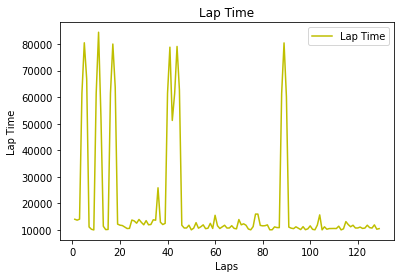

In [ ]:
c = []
for run in range(len(lapTime)): 
  c.append(lapTime[run, 1])
  c.append(lapTime[run, 2])
  c.append(lapTime[run, 3])


x = range(1, len(c)+1)


plt.title("Lap Time")
plt.plot(x, c, 'y', label="Lap Time")
plt.xlabel("Laps")
plt.ylabel("Lap Time")
plt.legend(loc='best')
plt.show()





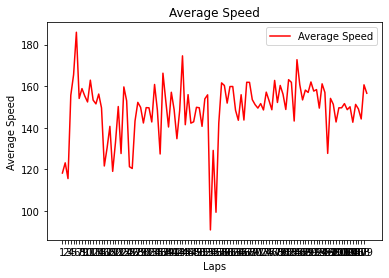

In [ ]:
plt.xticks(range(1,len(x)))

plt.title("Average Speed")
plt.plot(x, b, 'r', label="Average Speed")
plt.xlabel("Laps")
plt.ylabel("Average Speed")
plt.legend(loc='best')
plt.show()


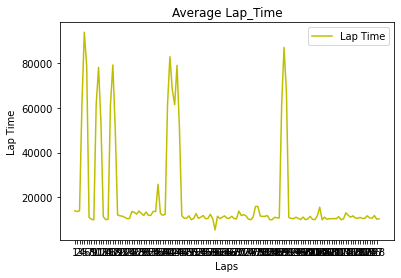

In [ ]:
x = x = range(1, len(c)+1)

plt.xticks(range(1,len(x)))

plt.title("Average Lap_Time")
plt.plot(x, c, 'y', label="Lap Time")
plt.xlabel("Laps")
plt.ylabel("Lap Time")
plt.legend(loc='best')
plt.show()